# 3.6.1 线性可分学习过程

导入功能模块

In [1]:
import sys

load_dataset_module_path = '../../'
sys.path.append(load_dataset_module_path)

from load_hyperspectral_dataset import (load_hyperspectral_data, y_labels,
                                        extract_features,
                                        plot_selected_categories,
                                        plot_decision_function)

In [2]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import cm
from sklearn.utils import shuffle
import seaborn as sns
import numpy as np

mpl.style.use('ggplot')

加载数据集

In [3]:
img_file_path = '../../Hyperspectral_Project/dc.tif'
label_file_path = '../../Hyperspectral_Project/dctest.project'

raw_X, raw_y, pixel_position = load_hyperspectral_data(img_file_path,
                                                       label_file_path)

hyperspectral_df =  extract_features(raw_X, raw_y)

In [4]:
cmap = sns.diverging_palette(20,200,sep=20,as_cmap=True)
selected_categories = ['Trees', 'Water']

In [5]:
loss_name = 'log'

-- Epoch 1
Norm: 13.18, NNZs: 2, Bias: -3.063147, T: 1629, Avg. loss: 0.023965
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 14.90, NNZs: 2, Bias: -3.615994, T: 3258, Avg. loss: 0.002965
Total training time: 0.00 seconds.
-- Epoch 3
Norm: 15.93, NNZs: 2, Bias: -3.873718, T: 4887, Avg. loss: 0.001749
Total training time: 0.00 seconds.
-- Epoch 4
Norm: 16.66, NNZs: 2, Bias: -4.066567, T: 6516, Avg. loss: 0.001251
Total training time: 0.00 seconds.
-- Epoch 5
Norm: 17.23, NNZs: 2, Bias: -4.194483, T: 8145, Avg. loss: 0.000976
Total training time: 0.00 seconds.
-- Epoch 6
Norm: 17.70, NNZs: 2, Bias: -4.317903, T: 9774, Avg. loss: 0.000802
Total training time: 0.00 seconds.
-- Epoch 7
Norm: 18.09, NNZs: 2, Bias: -4.417417, T: 11403, Avg. loss: 0.000681
Total training time: 0.00 seconds.
-- Epoch 8
Norm: 18.44, NNZs: 2, Bias: -4.496522, T: 13032, Avg. loss: 0.000593
Total training time: 0.00 seconds.
-- Epoch 9
Norm: 18.74, NNZs: 2, Bias: -4.583934, T: 14661, Avg. loss: 0.000525
Total 

/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_stochastic_gradient.py:577: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  ConvergenceWarning)


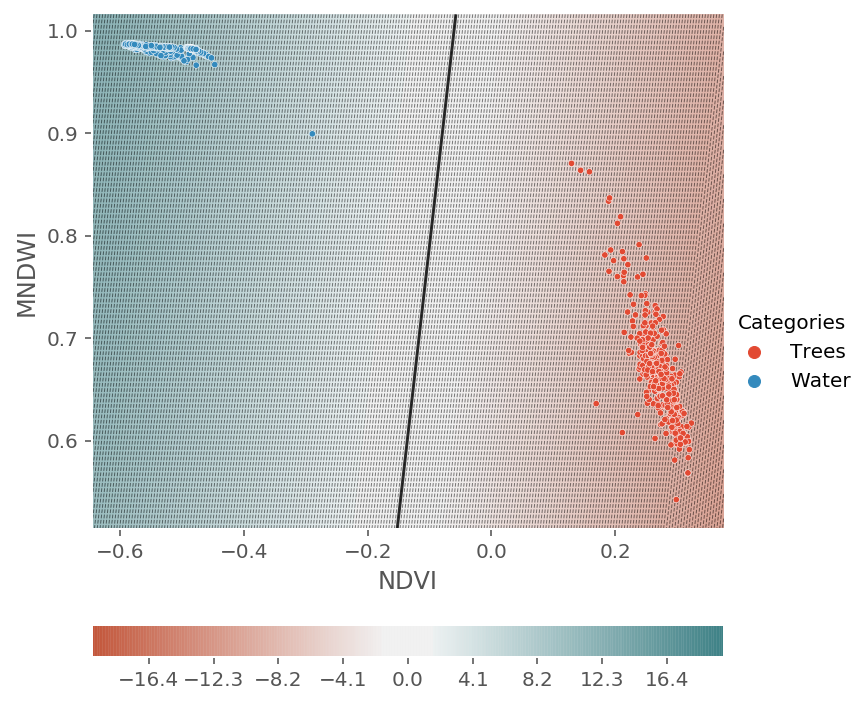

In [6]:
from sklearn.linear_model import SGDClassifier

model = SGDClassifier(
    max_iter=100,
    random_state=2,
    tol=1e-7,
    loss=loss_name,
    verbose=1,
    average=512,  #批次大小
    warm_start=True,
    eta0=1, 
    learning_rate="constant", 
    penalty=None,
    n_iter_no_change=2,)

selected_features, selected_target = plot_selected_categories(
    hyperspectral_df,
    seleted_features=['NDVI', 'MNDWI'],
    selected_categories=selected_categories)

selected_features, selected_target = shuffle(selected_features,
                                             selected_target,
                                             random_state=0)
model.fit(selected_features, selected_target)

plt.grid(b=False)

plot_decision_function(model, cmap, normalization_range=[-20, 20],normalization_step=2)
plt.savefig(
    f'SGD_classifier_{loss_name}_loss_{selected_categories[0]}_{selected_categories[1]}.pdf',
    bbox_inches='tight')

In [6]:
import math

In [7]:
def f(x):
    if x=='Trees':
        return -1.0
    if x=='Water':
        return 1.0
    
def log_loss(prediction,y_true):
    z = prediction * y_true
    return math.log(1.0 + math.exp(-z))


In [8]:
weights_list=[]
loss_list = []

-- Epoch 1
Norm: 13.13, NNZs: 2, Bias: -3.154713, T: 1629, Avg. loss: 0.024118
Total training time: 0.00 seconds.
-- Epoch 1
Norm: 15.05, NNZs: 2, Bias: -2.458069, T: 1629, Avg. loss: 0.004032
Total training time: 0.00 seconds.
-- Epoch 1
Norm: 16.27, NNZs: 2, Bias: -1.817048, T: 1629, Avg. loss: 0.002533
Total training time: 0.00 seconds.
-- Epoch 1
Norm: 17.18, NNZs: 2, Bias: -1.326142, T: 1629, Avg. loss: 0.001810
Total training time: 0.00 seconds.
-- Epoch 1
Norm: 17.89, NNZs: 2, Bias: -0.973658, T: 1629, Avg. loss: 0.001384
Total training time: 0.00 seconds.
-- Epoch 1
Norm: 18.48, NNZs: 2, Bias: -0.728966, T: 1629, Avg. loss: 0.001111
Total training time: 0.00 seconds.
-- Epoch 1
Norm: 18.98, NNZs: 2, Bias: -0.560965, T: 1629, Avg. loss: 0.000926
Total training time: 0.00 seconds.
-- Epoch 1
Norm: 19.41, NNZs: 2, Bias: -0.444889, T: 1629, Avg. loss: 0.000792
Total training time: 0.00 seconds.
-- Epoch 1
Norm: 19.79, NNZs: 2, Bias: -0.363266, T: 1629, Avg. loss: 0.000692
Total tra

/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 22.46, NNZs: 2, Bias: -0.107314, T: 1629, Avg. loss: 0.000273
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 22.60, NNZs: 2, Bias: -0.101470, T: 1629, Avg. loss: 0.000260
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 22.74, NNZs: 2, Bias: -0.096244, T: 1629, Avg. loss: 0.000248
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 22.87, NNZs: 2, Bias: -0.091541, T: 1629, Avg. loss: 0.000237
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 22.99, NNZs: 2, Bias: -0.087283, T: 1629, Avg. loss: 0.000227
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 23.11, NNZs: 2, Bias: -0.083410, T: 1629, Avg. loss: 0.000218
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 23.23, NNZs: 2, Bias: -0.079870, T: 1629, Avg. loss: 0.000210
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 23.34, NNZs: 2, Bias: -0.076622, T: 1629, Avg. loss: 0.000202
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 23.44, NNZs: 2, Bias: -0.073631, T: 1629, Avg. loss: 0.000195
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 23.55, NNZs: 2, Bias: -0.070866, T: 1629, Avg. loss: 0.000188
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 23.65, NNZs: 2, Bias: -0.068303, T: 1629, Avg. loss: 0.000182
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 23.74, NNZs: 2, Bias: -0.065919, T: 1629, Avg. loss: 0.000176
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 23.84, NNZs: 2, Bias: -0.063698, T: 1629, Avg. loss: 0.000170
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 23.93, NNZs: 2, Bias: -0.061621, T: 1629, Avg. loss: 0.000165
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.01, NNZs: 2, Bias: -0.059677, T: 1629, Avg. loss: 0.000160
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.10, NNZs: 2, Bias: -0.057851, T: 1629, Avg. loss: 0.000156
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.18, NNZs: 2, Bias: -0.056134, T: 1629, Avg. loss: 0.000151
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.26, NNZs: 2, Bias: -0.054516, T: 1629, Avg. loss: 0.000147
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.34, NNZs: 2, Bias: -0.052989, T: 1629, Avg. loss: 0.000144
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.42, NNZs: 2, Bias: -0.051545, T: 1629, Avg. loss: 0.000140
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.49, NNZs: 2, Bias: -0.050177, T: 1629, Avg. loss: 0.000136
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.56, NNZs: 2, Bias: -0.048880, T: 1629, Avg. loss: 0.000133
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.63, NNZs: 2, Bias: -0.047648, T: 1629, Avg. loss: 0.000130
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.70, NNZs: 2, Bias: -0.046477, T: 1629, Avg. loss: 0.000127
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.77, NNZs: 2, Bias: -0.045362, T: 1629, Avg. loss: 0.000124
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.84, NNZs: 2, Bias: -0.044299, T: 1629, Avg. loss: 0.000121
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.90, NNZs: 2, Bias: -0.043284, T: 1629, Avg. loss: 0.000119
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 24.96, NNZs: 2, Bias: -0.042315, T: 1629, Avg. loss: 0.000116
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.03, NNZs: 2, Bias: -0.041388, T: 1629, Avg. loss: 0.000114
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.09, NNZs: 2, Bias: -0.040500, T: 1629, Avg. loss: 0.000112
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.15, NNZs: 2, Bias: -0.039650, T: 1629, Avg. loss: 0.000109
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.20, NNZs: 2, Bias: -0.038834, T: 1629, Avg. loss: 0.000107
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.26, NNZs: 2, Bias: -0.038052, T: 1629, Avg. loss: 0.000105
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.32, NNZs: 2, Bias: -0.037300, T: 1629, Avg. loss: 0.000103
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.37, NNZs: 2, Bias: -0.036577, T: 1629, Avg. loss: 0.000101
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.43, NNZs: 2, Bias: -0.035881, T: 1629, Avg. loss: 0.000099
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.48, NNZs: 2, Bias: -0.035211, T: 1629, Avg. loss: 0.000098
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.53, NNZs: 2, Bias: -0.034566, T: 1629, Avg. loss: 0.000096
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.58, NNZs: 2, Bias: -0.033944, T: 1629, Avg. loss: 0.000094
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.63, NNZs: 2, Bias: -0.033343, T: 1629, Avg. loss: 0.000093
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.68, NNZs: 2, Bias: -0.032764, T: 1629, Avg. loss: 0.000091
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.73, NNZs: 2, Bias: -0.032204, T: 1629, Avg. loss: 0.000090
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.78, NNZs: 2, Bias: -0.031662, T: 1629, Avg. loss: 0.000088
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.83, NNZs: 2, Bias: -0.031139, T: 1629, Avg. loss: 0.000087
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.87, NNZs: 2, Bias: -0.030632, T: 1629, Avg. loss: 0.000086
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.92, NNZs: 2, Bias: -0.030142, T: 1629, Avg. loss: 0.000084
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 25.96, NNZs: 2, Bias: -0.029667, T: 1629, Avg. loss: 0.000083
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.01, NNZs: 2, Bias: -0.029207, T: 1629, Avg. loss: 0.000082
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.05, NNZs: 2, Bias: -0.028760, T: 1629, Avg. loss: 0.000081
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.09, NNZs: 2, Bias: -0.028327, T: 1629, Avg. loss: 0.000080
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.14, NNZs: 2, Bias: -0.027907, T: 1629, Avg. loss: 0.000078
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.18, NNZs: 2, Bias: -0.027499, T: 1629, Avg. loss: 0.000077
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.22, NNZs: 2, Bias: -0.027102, T: 1629, Avg. loss: 0.000076
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.26, NNZs: 2, Bias: -0.026717, T: 1629, Avg. loss: 0.000075
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.30, NNZs: 2, Bias: -0.026343, T: 1629, Avg. loss: 0.000074
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.34, NNZs: 2, Bias: -0.025978, T: 1629, Avg. loss: 0.000073
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.38, NNZs: 2, Bias: -0.025624, T: 1629, Avg. loss: 0.000072
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.42, NNZs: 2, Bias: -0.025279, T: 1629, Avg. loss: 0.000071
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.46, NNZs: 2, Bias: -0.024943, T: 1629, Avg. loss: 0.000071
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.49, NNZs: 2, Bias: -0.024616, T: 1629, Avg. loss: 0.000070
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.53, NNZs: 2, Bias: -0.024298, T: 1629, Avg. loss: 0.000069
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.57, NNZs: 2, Bias: -0.023987, T: 1629, Avg. loss: 0.000068
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.60, NNZs: 2, Bias: -0.023684, T: 1629, Avg. loss: 0.000067
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.64, NNZs: 2, Bias: -0.023389, T: 1629, Avg. loss: 0.000066
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.67, NNZs: 2, Bias: -0.023101, T: 1629, Avg. loss: 0.000066
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.71, NNZs: 2, Bias: -0.022820, T: 1629, Avg. loss: 0.000065
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.74, NNZs: 2, Bias: -0.022546, T: 1629, Avg. loss: 0.000064
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.78, NNZs: 2, Bias: -0.022278, T: 1629, Avg. loss: 0.000063
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.81, NNZs: 2, Bias: -0.022016, T: 1629, Avg. loss: 0.000063
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.84, NNZs: 2, Bias: -0.021760, T: 1629, Avg. loss: 0.000062
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.88, NNZs: 2, Bias: -0.021511, T: 1629, Avg. loss: 0.000061
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.91, NNZs: 2, Bias: -0.021266, T: 1629, Avg. loss: 0.000061
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.94, NNZs: 2, Bias: -0.021028, T: 1629, Avg. loss: 0.000060
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 26.97, NNZs: 2, Bias: -0.020794, T: 1629, Avg. loss: 0.000059
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.01, NNZs: 2, Bias: -0.020566, T: 1629, Avg. loss: 0.000059
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.04, NNZs: 2, Bias: -0.020342, T: 1629, Avg. loss: 0.000058
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.07, NNZs: 2, Bias: -0.020124, T: 1629, Avg. loss: 0.000058
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.10, NNZs: 2, Bias: -0.019910, T: 1629, Avg. loss: 0.000057
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.13, NNZs: 2, Bias: -0.019700, T: 1629, Avg. loss: 0.000056
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.16, NNZs: 2, Bias: -0.019495, T: 1629, Avg. loss: 0.000056
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.19, NNZs: 2, Bias: -0.019294, T: 1629, Avg. loss: 0.000055
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.22, NNZs: 2, Bias: -0.019097, T: 1629, Avg. loss: 0.000055
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.25, NNZs: 2, Bias: -0.018904, T: 1629, Avg. loss: 0.000054
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.27, NNZs: 2, Bias: -0.018714, T: 1629, Avg. loss: 0.000054
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.30, NNZs: 2, Bias: -0.018529, T: 1629, Avg. loss: 0.000053
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.33, NNZs: 2, Bias: -0.018347, T: 1629, Avg. loss: 0.000053
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.36, NNZs: 2, Bias: -0.018169, T: 1629, Avg. loss: 0.000052
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.39, NNZs: 2, Bias: -0.017994, T: 1629, Avg. loss: 0.000052
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.41, NNZs: 2, Bias: -0.017822, T: 1629, Avg. loss: 0.000051
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.44, NNZs: 2, Bias: -0.017654, T: 1629, Avg. loss: 0.000051
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.47, NNZs: 2, Bias: -0.017488, T: 1629, Avg. loss: 0.000050
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.50, NNZs: 2, Bias: -0.017326, T: 1629, Avg. loss: 0.000050
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.52, NNZs: 2, Bias: -0.017167, T: 1629, Avg. loss: 0.000050
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.55, NNZs: 2, Bias: -0.017010, T: 1629, Avg. loss: 0.000049
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.57, NNZs: 2, Bias: -0.016857, T: 1629, Avg. loss: 0.000049
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.60, NNZs: 2, Bias: -0.016706, T: 1629, Avg. loss: 0.000048
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.63, NNZs: 2, Bias: -0.016557, T: 1629, Avg. loss: 0.000048
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.65, NNZs: 2, Bias: -0.016412, T: 1629, Avg. loss: 0.000048
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.68, NNZs: 2, Bias: -0.016269, T: 1629, Avg. loss: 0.000047
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.70, NNZs: 2, Bias: -0.016128, T: 1629, Avg. loss: 0.000047
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.73, NNZs: 2, Bias: -0.015990, T: 1629, Avg. loss: 0.000046
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.75, NNZs: 2, Bias: -0.015854, T: 1629, Avg. loss: 0.000046
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.77, NNZs: 2, Bias: -0.015720, T: 1629, Avg. loss: 0.000046
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.80, NNZs: 2, Bias: -0.015589, T: 1629, Avg. loss: 0.000045
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.82, NNZs: 2, Bias: -0.015459, T: 1629, Avg. loss: 0.000045
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.85, NNZs: 2, Bias: -0.015332, T: 1629, Avg. loss: 0.000045
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.87, NNZs: 2, Bias: -0.015207, T: 1629, Avg. loss: 0.000044
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.89, NNZs: 2, Bias: -0.015084, T: 1629, Avg. loss: 0.000044
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.92, NNZs: 2, Bias: -0.014963, T: 1629, Avg. loss: 0.000044
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.94, NNZs: 2, Bias: -0.014843, T: 1629, Avg. loss: 0.000043
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.96, NNZs: 2, Bias: -0.014726, T: 1629, Avg. loss: 0.000043
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 27.99, NNZs: 2, Bias: -0.014610, T: 1629, Avg. loss: 0.000043
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.01, NNZs: 2, Bias: -0.014497, T: 1629, Avg. loss: 0.000042
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.03, NNZs: 2, Bias: -0.014385, T: 1629, Avg. loss: 0.000042
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.05, NNZs: 2, Bias: -0.014274, T: 1629, Avg. loss: 0.000042
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.07, NNZs: 2, Bias: -0.014166, T: 1629, Avg. loss: 0.000041
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.10, NNZs: 2, Bias: -0.014059, T: 1629, Avg. loss: 0.000041
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.12, NNZs: 2, Bias: -0.013953, T: 1629, Avg. loss: 0.000041
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.14, NNZs: 2, Bias: -0.013849, T: 1629, Avg. loss: 0.000041
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.16, NNZs: 2, Bias: -0.013747, T: 1629, Avg. loss: 0.000040
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.18, NNZs: 2, Bias: -0.013646, T: 1629, Avg. loss: 0.000040
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.20, NNZs: 2, Bias: -0.013547, T: 1629, Avg. loss: 0.000040
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.22, NNZs: 2, Bias: -0.013449, T: 1629, Avg. loss: 0.000039
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.24, NNZs: 2, Bias: -0.013352, T: 1629, Avg. loss: 0.000039
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.26, NNZs: 2, Bias: -0.013257, T: 1629, Avg. loss: 0.000039
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.29, NNZs: 2, Bias: -0.013163, T: 1629, Avg. loss: 0.000039
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.31, NNZs: 2, Bias: -0.013070, T: 1629, Avg. loss: 0.000038
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.33, NNZs: 2, Bias: -0.012979, T: 1629, Avg. loss: 0.000038
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.35, NNZs: 2, Bias: -0.012889, T: 1629, Avg. loss: 0.000038
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.37, NNZs: 2, Bias: -0.012800, T: 1629, Avg. loss: 0.000038
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.39, NNZs: 2, Bias: -0.012713, T: 1629, Avg. loss: 0.000037
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.41, NNZs: 2, Bias: -0.012626, T: 1629, Avg. loss: 0.000037
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.42, NNZs: 2, Bias: -0.012541, T: 1629, Avg. loss: 0.000037
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.44, NNZs: 2, Bias: -0.012457, T: 1629, Avg. loss: 0.000037
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.46, NNZs: 2, Bias: -0.012374, T: 1629, Avg. loss: 0.000036
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.48, NNZs: 2, Bias: -0.012292, T: 1629, Avg. loss: 0.000036
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.50, NNZs: 2, Bias: -0.012211, T: 1629, Avg. loss: 0.000036
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.52, NNZs: 2, Bias: -0.012131, T: 1629, Avg. loss: 0.000036
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.54, NNZs: 2, Bias: -0.012052, T: 1629, Avg. loss: 0.000036
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.56, NNZs: 2, Bias: -0.011974, T: 1629, Avg. loss: 0.000035
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.58, NNZs: 2, Bias: -0.011898, T: 1629, Avg. loss: 0.000035
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.60, NNZs: 2, Bias: -0.011822, T: 1629, Avg. loss: 0.000035
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.61, NNZs: 2, Bias: -0.011747, T: 1629, Avg. loss: 0.000035
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.63, NNZs: 2, Bias: -0.011673, T: 1629, Avg. loss: 0.000034
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.65, NNZs: 2, Bias: -0.011600, T: 1629, Avg. loss: 0.000034
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.67, NNZs: 2, Bias: -0.011528, T: 1629, Avg. loss: 0.000034
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.69, NNZs: 2, Bias: -0.011457, T: 1629, Avg. loss: 0.000034
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.70, NNZs: 2, Bias: -0.011386, T: 1629, Avg. loss: 0.000034
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.72, NNZs: 2, Bias: -0.011317, T: 1629, Avg. loss: 0.000033
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.74, NNZs: 2, Bias: -0.011248, T: 1629, Avg. loss: 0.000033
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.76, NNZs: 2, Bias: -0.011180, T: 1629, Avg. loss: 0.000033
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.77, NNZs: 2, Bias: -0.011113, T: 1629, Avg. loss: 0.000033
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.79, NNZs: 2, Bias: -0.011047, T: 1629, Avg. loss: 0.000033
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.81, NNZs: 2, Bias: -0.010981, T: 1629, Avg. loss: 0.000033
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.83, NNZs: 2, Bias: -0.010917, T: 1629, Avg. loss: 0.000032
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.84, NNZs: 2, Bias: -0.010853, T: 1629, Avg. loss: 0.000032
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.86, NNZs: 2, Bias: -0.010789, T: 1629, Avg. loss: 0.000032
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.88, NNZs: 2, Bias: -0.010727, T: 1629, Avg. loss: 0.000032
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.89, NNZs: 2, Bias: -0.010665, T: 1629, Avg. loss: 0.000032
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.91, NNZs: 2, Bias: -0.010604, T: 1629, Avg. loss: 0.000032
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.93, NNZs: 2, Bias: -0.010544, T: 1629, Avg. loss: 0.000031
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.94, NNZs: 2, Bias: -0.010484, T: 1629, Avg. loss: 0.000031
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.96, NNZs: 2, Bias: -0.010425, T: 1629, Avg. loss: 0.000031
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.98, NNZs: 2, Bias: -0.010366, T: 1629, Avg. loss: 0.000031
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 28.99, NNZs: 2, Bias: -0.010309, T: 1629, Avg. loss: 0.000031
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.01, NNZs: 2, Bias: -0.010251, T: 1629, Avg. loss: 0.000031
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.02, NNZs: 2, Bias: -0.010195, T: 1629, Avg. loss: 0.000030
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.04, NNZs: 2, Bias: -0.010139, T: 1629, Avg. loss: 0.000030
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.06, NNZs: 2, Bias: -0.010084, T: 1629, Avg. loss: 0.000030
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.07, NNZs: 2, Bias: -0.010029, T: 1629, Avg. loss: 0.000030
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.09, NNZs: 2, Bias: -0.009975, T: 1629, Avg. loss: 0.000030
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.10, NNZs: 2, Bias: -0.009921, T: 1629, Avg. loss: 0.000030
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.12, NNZs: 2, Bias: -0.009868, T: 1629, Avg. loss: 0.000029
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.13, NNZs: 2, Bias: -0.009816, T: 1629, Avg. loss: 0.000029
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.15, NNZs: 2, Bias: -0.009764, T: 1629, Avg. loss: 0.000029
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.16, NNZs: 2, Bias: -0.009713, T: 1629, Avg. loss: 0.000029
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.18, NNZs: 2, Bias: -0.009662, T: 1629, Avg. loss: 0.000029
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.19, NNZs: 2, Bias: -0.009612, T: 1629, Avg. loss: 0.000029
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.21, NNZs: 2, Bias: -0.009562, T: 1629, Avg. loss: 0.000029
Total training time: 0.00 seconds.


/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


-- Epoch 1
Norm: 29.22, NNZs: 2, Bias: -0.009513, T: 1629, Avg. loss: 0.000028
Total training time: 0.00 seconds.


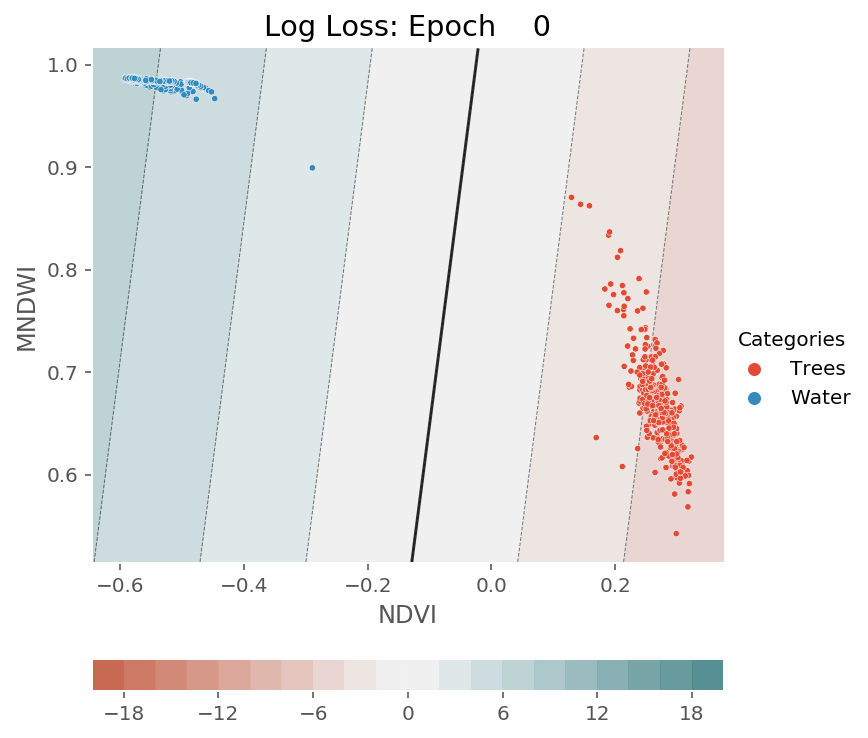

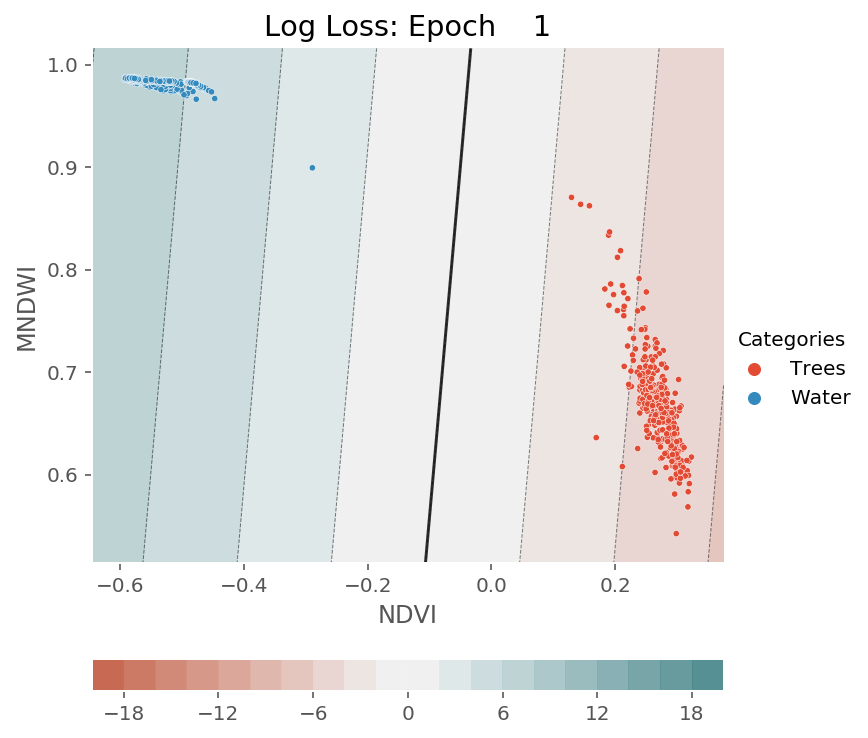

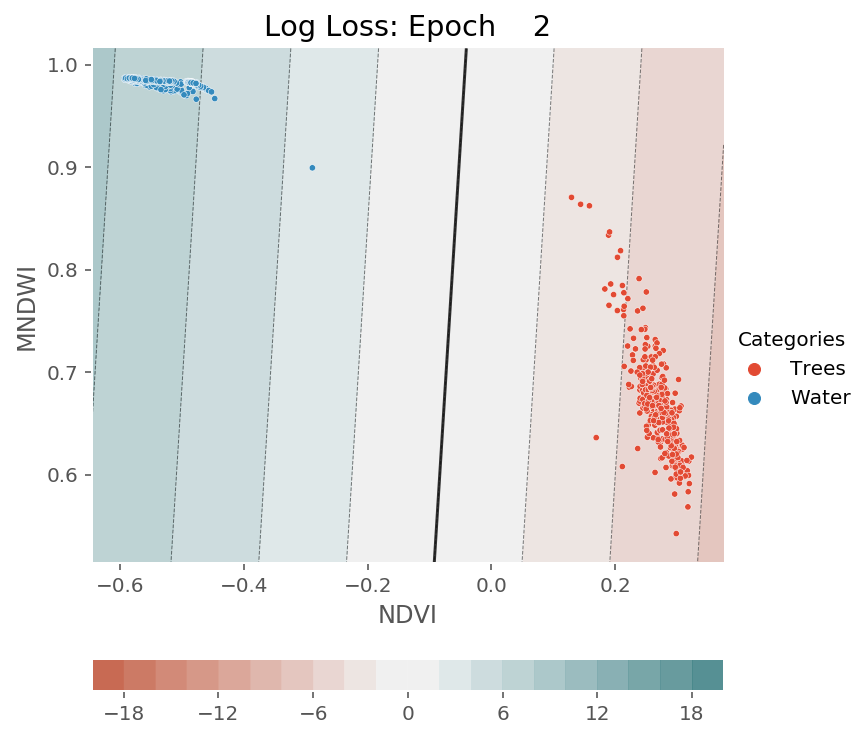

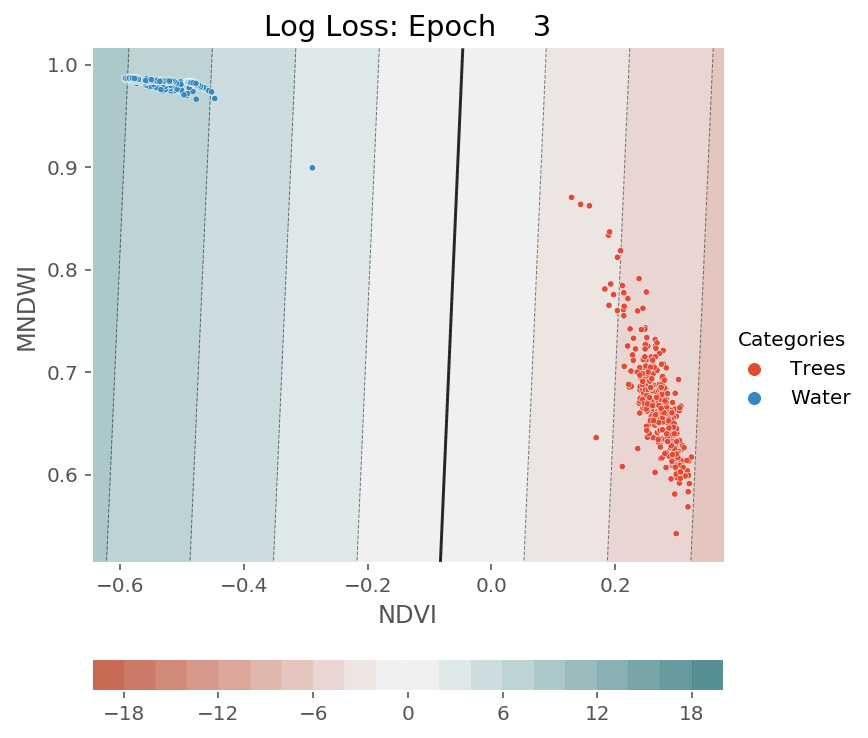

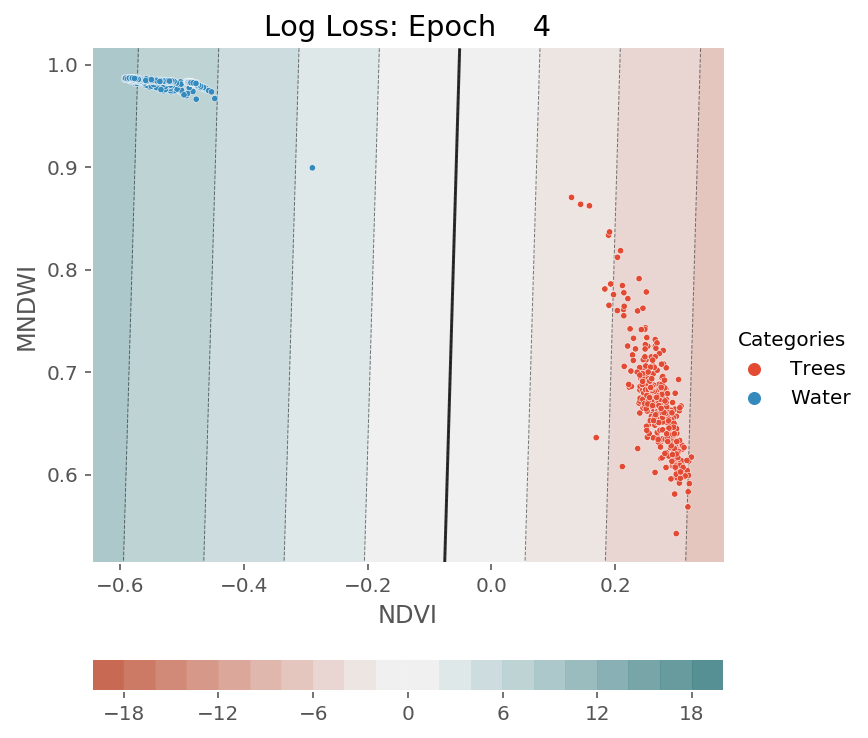

...

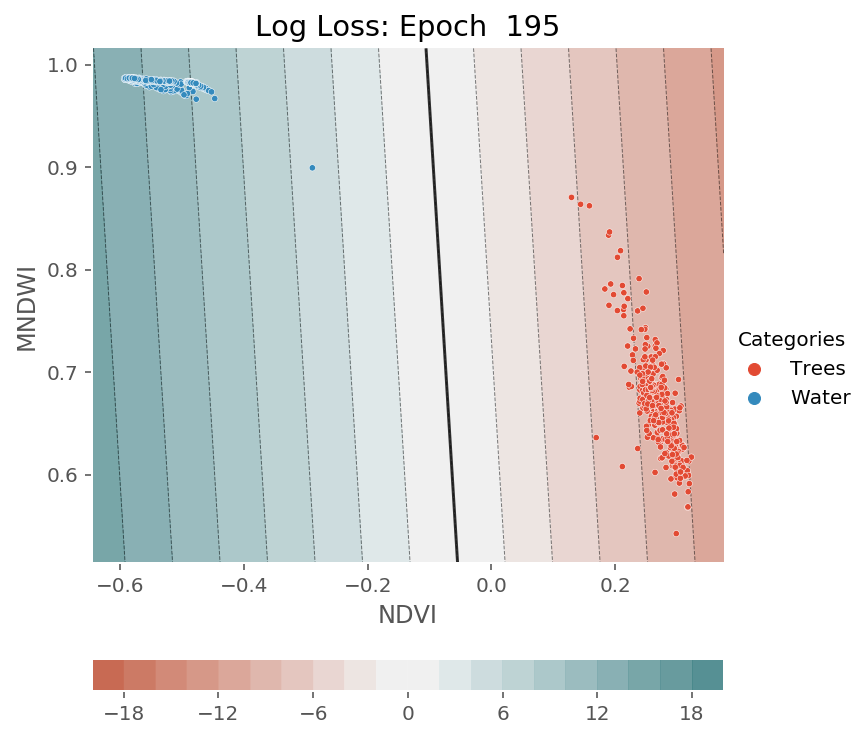

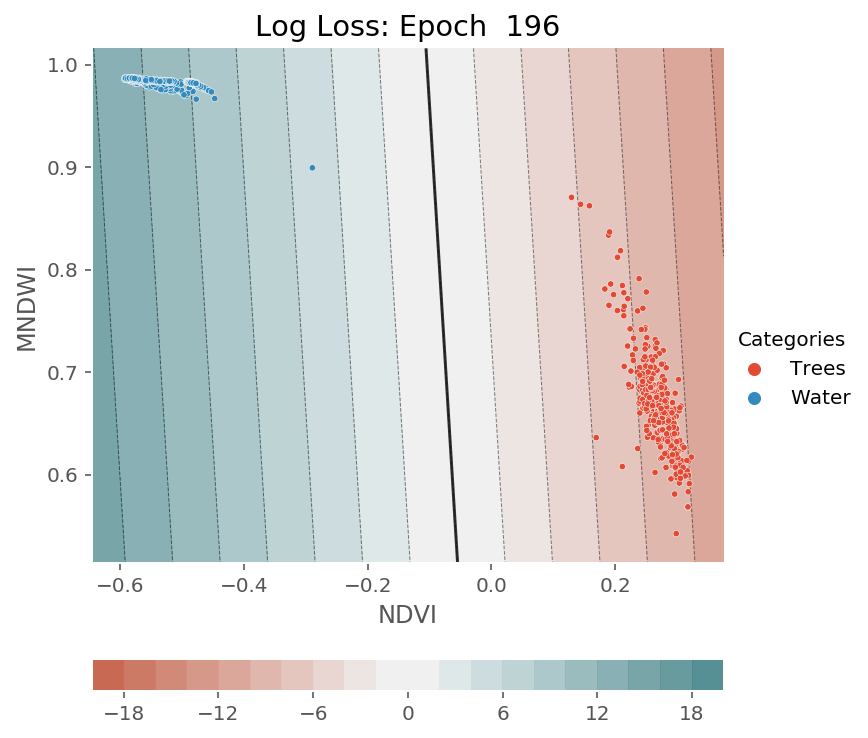

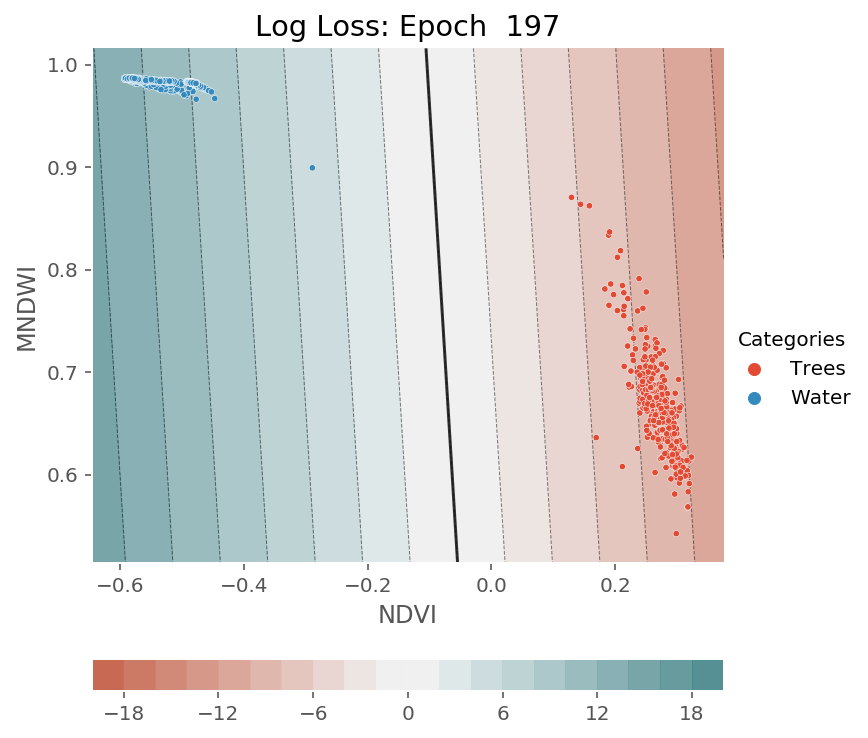

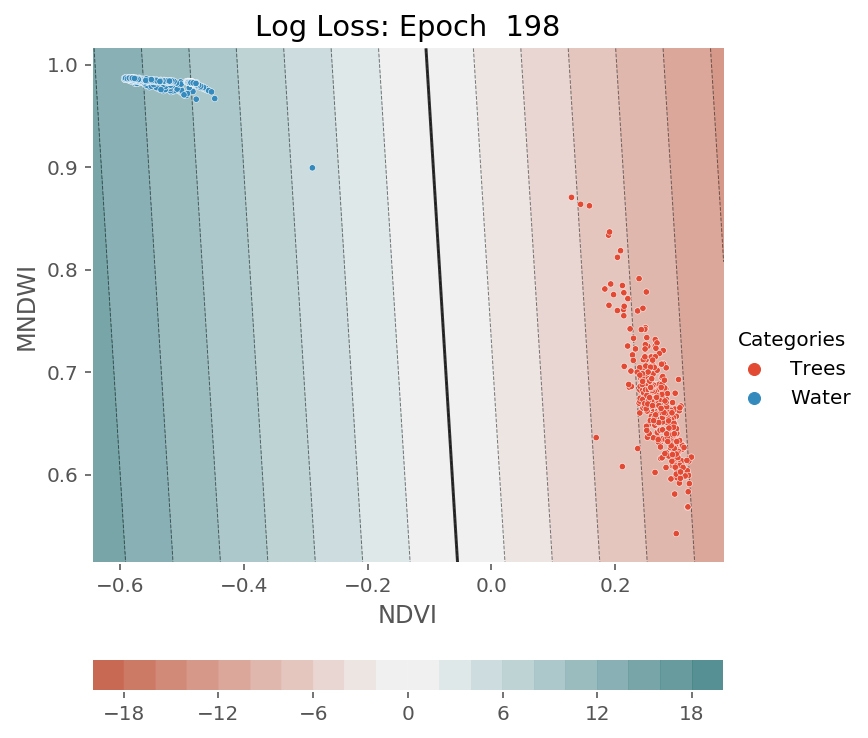

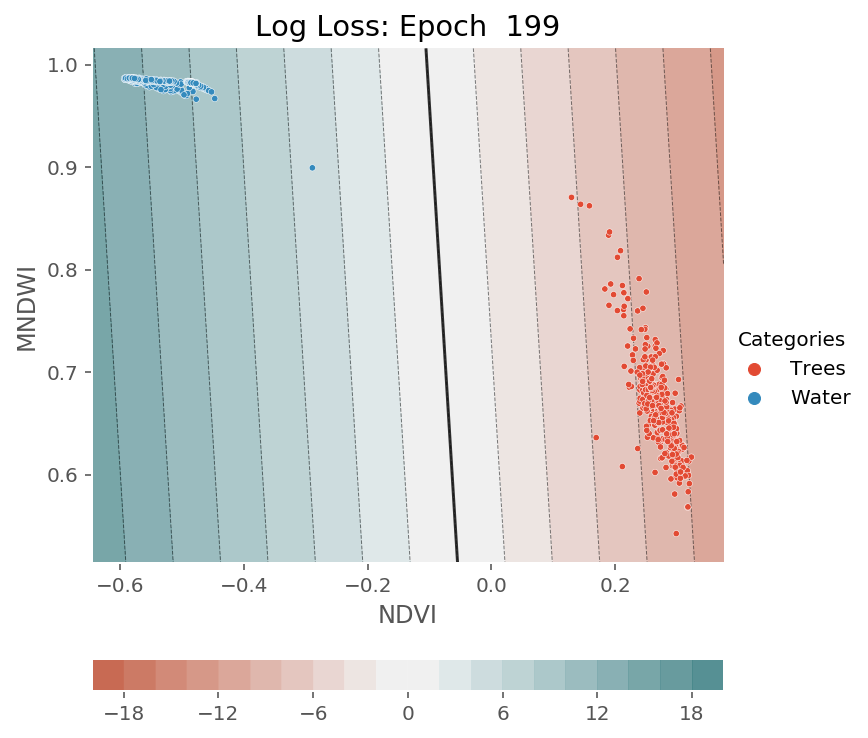

In [9]:
from sklearn.linear_model import SGDClassifier

n_iter = 200


model = SGDClassifier(
    max_iter=1,
    random_state=2,
    tol=1e-7,
    loss=loss_name,
    verbose=1,
    average=512,  #批次大小
    warm_start=True,
    eta0=1, 
    learning_rate="constant", 
    penalty=None,
    n_iter_no_change=2,)


for i in range(n_iter):
    
    selected_features, selected_target = plot_selected_categories(
    hyperspectral_df,
    seleted_features=['NDVI', 'MNDWI'],
    selected_categories=selected_categories,)
    
    
    ax = plt.gca()
    ax.set_title(f'Log Loss: Epoch {i:>4d}')
    plt.grid(b=False)

    model.partial_fit(selected_features, selected_target,classes=selected_categories)
    plot_decision_function(model, cmap, normalization_range=[-20, 20],normalization_step=2)
    plt.savefig(f'n_iter_{loss_name}_loss/{loss_name}_loss_{selected_categories[0]}_{selected_categories[1]}_{i}.jpg',dpi=100,
            bbox_inches='tight',quality=90)
    
    #save weights
    weights_list.append(model.coef_[0].copy())
    
    #compute loss
    X, y = model._validate_data(selected_features, selected_target)   
    y_t = np.vectorize(f)(y)
    y_p = model.decision_function(X)
    mean_loss = np.vectorize(log_loss)(y_p,y_t).mean()
    loss_list.append(mean_loss)

In [10]:
import imageio

file_names = [
    f'n_iter_{loss_name}_loss/{loss_name}_loss_{selected_categories[0]}_{selected_categories[1]}_{i}.jpg'
    for i in range(n_iter)
]

frames = []

for image_name in file_names:
    frames.append(imageio.imread(image_name))

imageio.mimsave(
    f'training_{loss_name}_loss_{selected_categories[0]}_{selected_categories[1]}.gif',
    frames,
    'GIF',
    duration=0.05)

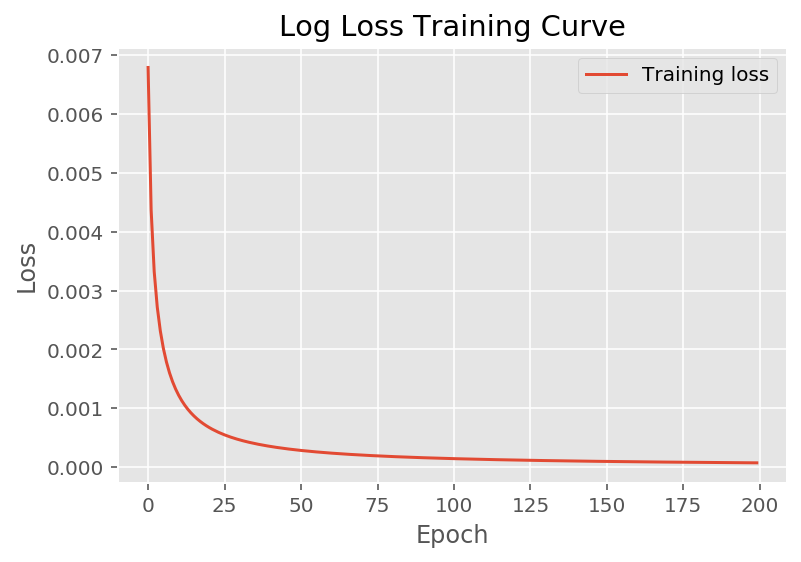

In [11]:
plt.plot(range(len(loss_list)),loss_list,label='Training loss')
plt.legend()

plt.xlabel('Epoch')
plt.ylabel('Loss')

plt.title(f'{loss_name.capitalize()} Loss Training Curve') 
plt.savefig(f'{loss_name}_loss_{selected_categories[0]}_{selected_categories[1]}_training_loss_curve.pdf',
            bbox_inches='tight')

In [12]:
xlim = (-45, -8)
ylim = (-10, 6)

In [13]:
x = np.linspace(xlim[0], xlim[1], 200)
y = np.linspace(ylim[0], ylim[1], 200)
Y, X = np.meshgrid(y, x)
xy = np.vstack([X.ravel(), Y.ravel()]).T

In [14]:
loss_surface = []

In [15]:
X_s, y_s = model._validate_data(selected_features, selected_target)
y_t = np.vectorize(f)(y_s)

for i in xy:
    model.coef_=np.array([i]) 
    y_p = model.decision_function(X_s)
    mean_loss = np.vectorize(log_loss)(y_p,y_t).mean()
    loss_surface.append(mean_loss)

In [16]:
import matplotlib
from matplotlib import cm

/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (T

/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (T

/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (T

/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (T

/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (T

/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (T

/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (T

/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
/Users/yns/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (T

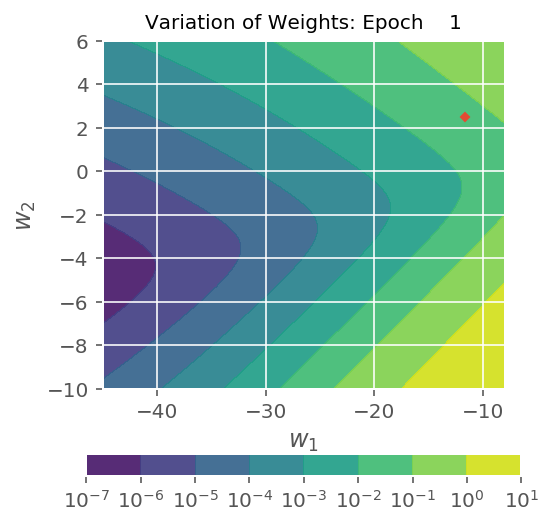

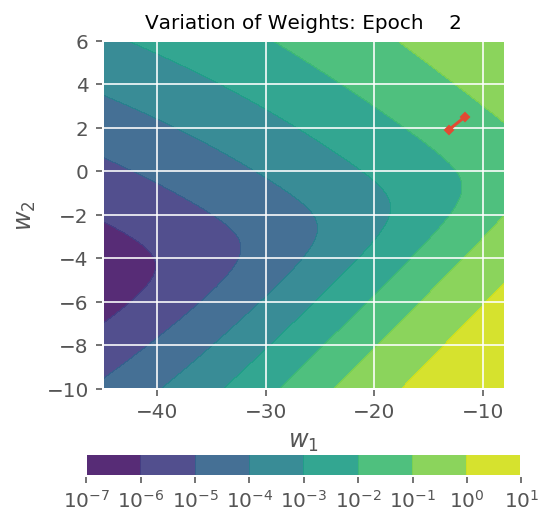

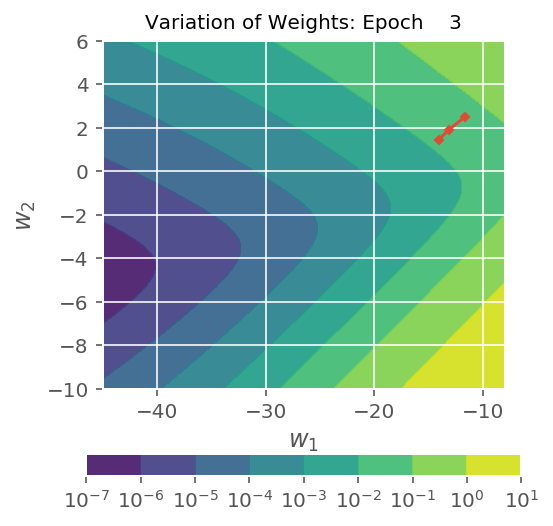

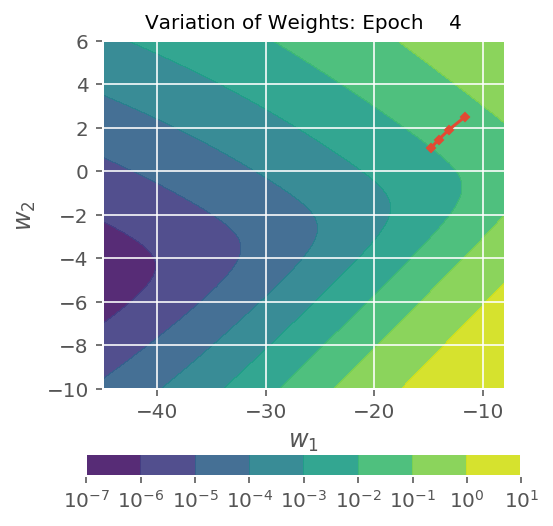

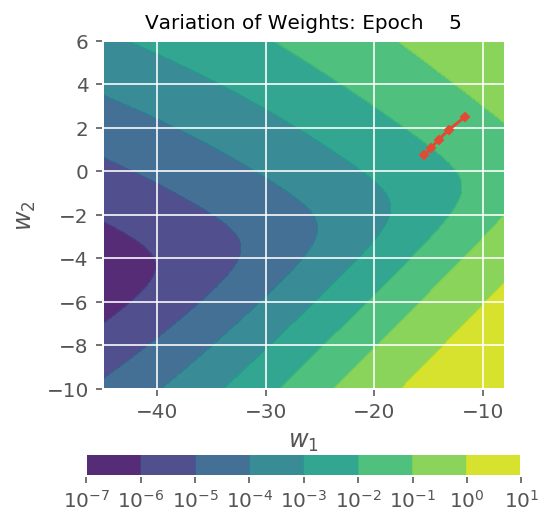

...

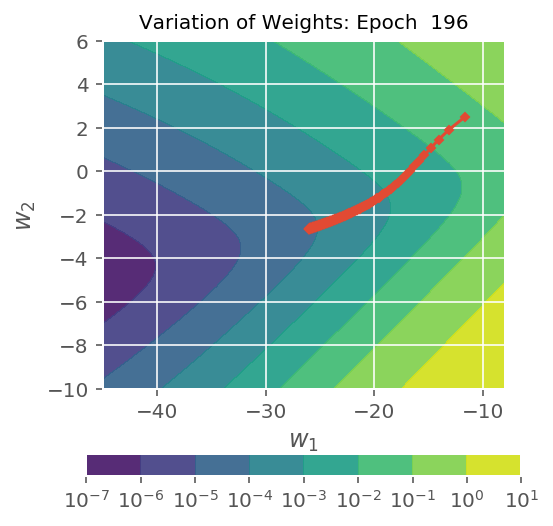

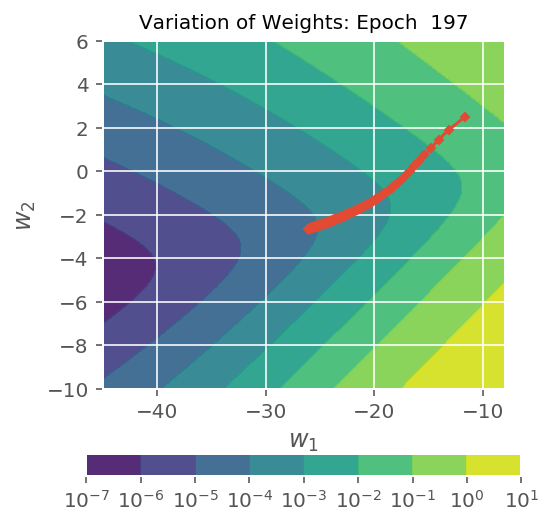

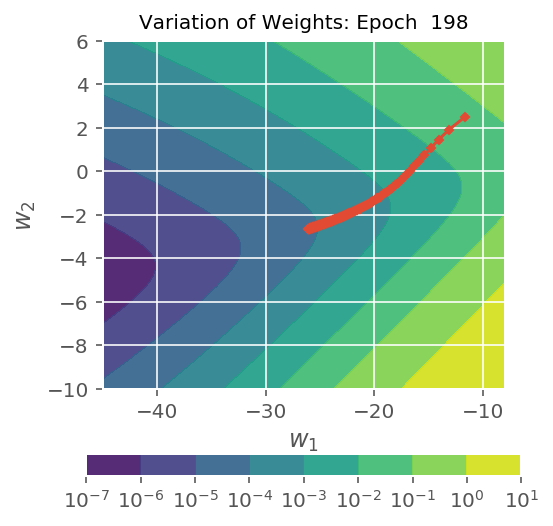

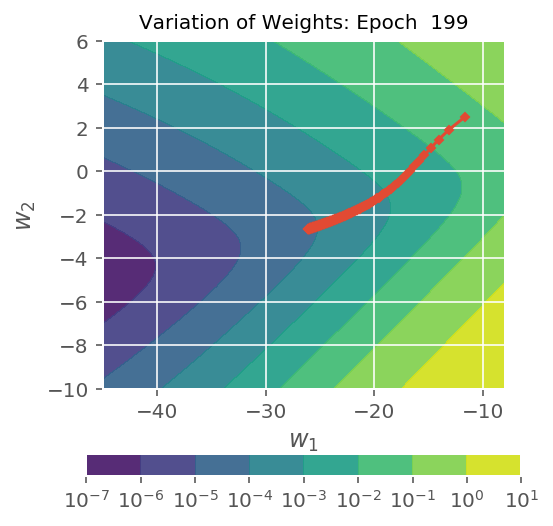

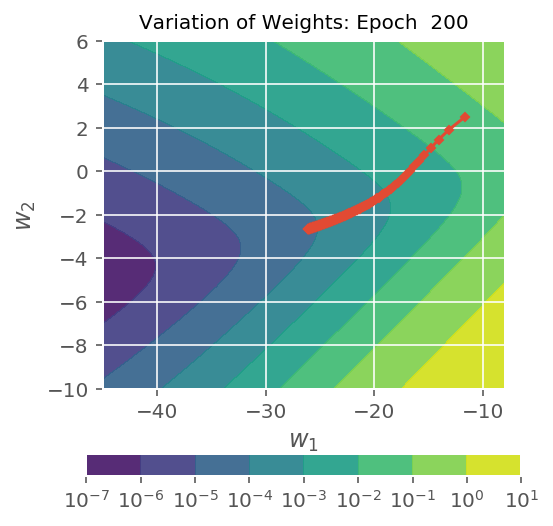

In [23]:


for i in range(n_iter):
    
# for i in range(3):
     
    fig = plt.figure()
    plt.plot(np.array(weights_list)[0:i+1, 0],
             np.array(weights_list)[0:i+1, 1],
             marker='D',
             markersize=3,
             color=plt.rcParams['axes.prop_cycle'].by_key()['color'][0],
             label='Training',
            )
    #plt.legend()

    plt.xlabel('$w_1$')
    plt.ylabel('$w_2$')
    
    
    
    
    plt.xlim(xlim[0], xlim[1])
    plt.ylim(ylim[0], ylim[1])

    plt.title(f'Variation of Weights: Epoch {i+1:>4d}',fontsize=10)
    
    
    
    ax = plt.gca()

    Z = np.array(loss_surface).reshape(X.shape)
    #levels = np.arange(0,0.6,0.01)
    cset1 = ax.contourf(X, Y, Z,
                        norm=matplotlib.colors.LogNorm(),
                        alpha=.9,
                        zorder = -2,
                        #cmap=sns.diverging_palette(20,200,sep=20,as_cmap=True)
                       ) 

    plt.colorbar(cset1,
                     orientation='horizontal',
                     fraction=0.05, 
                     ax=ax)
    ax.set(xlim=xlim, ylim=ylim)
    ax.set_aspect(2)
    
    plt.savefig(
        f'n_iter_{loss_name}_loss_weights/weights_{selected_categories[0]}_{selected_categories[1]}_{i}.jpg',
        dpi=200,
        bbox_inches='tight',
        quality=95)

In [24]:
import imageio

file_names = [
    f'n_iter_{loss_name}_loss_weights/weights_{selected_categories[0]}_{selected_categories[1]}_{i}.jpg'
    for i in range(n_iter)
]

frames = []

for image_name in file_names:
    frames.append(imageio.imread(image_name))

imageio.mimsave(
    f'weights_{loss_name}_loss_{selected_categories[0]}_{selected_categories[1]}.gif',
    frames,
    'GIF',
    duration=0.1)